In [1]:
import IPython
from IPython.display import Image, Audio, Video
import music21 as ms
import fractions
from midi2audio import FluidSynth
import tensorflow 
import numpy as np 
import pandas as pd 
#from collections import Counter
#import sys
from sklearn.model_selection import train_test_split
#import warnings
import os
import matplotlib.pyplot as plt
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
from tensorflow.keras.callbacks import ModelCheckpoint
import time
from plotly import graph_objs as go
#from sklearn.preprocessing import RobustScaler
import tensorflow as tf

Primeiro passo, vamos setar a variável de ambiente para trabalhar com o music21 sem problemas, lembrando que você precisa ter o aplicativo musescore instalado em sua máquina para conseguir aproveitar todos os recursos desta biblioteca python.

In [2]:
ms.environment.set('musescoreDirectPNGPath', 'C:/Program Files/MuseScore 3/bin/MuseScore3.exe')

# Loading Files

In [3]:
#Getting all songs files from directory
def getSongsFromDir(filepath):
    all_songs = []
    for i in os.listdir(filepath):
        if i.endswith(".mid"):
            tr = filepath+i
            midi = ms.converter.parse(tr)
            obj = {
                'name': i.split('.')[0],
                'song': midi
            }

            all_songs.append(obj)
            
    return all_songs

In [4]:
def removeTempo(song):
    new = ms.stream.Score()
    for part in song:
        if isinstance(part, ms.stream.Part):
            new_p = ms.stream.Part()
            for measure in part:
                if isinstance(measure, ms.stream.Measure):
                    new_m = ms.stream.Measure()
                   
                    for obj in measure:
                        '''
                        if not isinstance(obj, ms.tempo.MetronomeMark):
                            new_m.append(obj)
                        '''
                            
                        if isinstance(obj, ms.tempo.MetronomeMark):
                            quart = obj.getQuarterBPM()
                            quart = round(quart/4, 2)
                            
                            obj.setQuarterBPM(quart)
                        new_m.append(obj)   
                        
                    new_p.append(new_m)

            new.append(new_p)
            
    return new                            

In [5]:
def separeteObjects(obj, listNotations, songName, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator, _measure):
    if isinstance(obj, ms.clef.TrebleClef):
        _clef = 'treble'
    elif isinstance(obj, ms.clef.BassClef):
        _clef = 'bass'

    elif isinstance(obj, ms.key.Key):
        _tempKey = obj.name                

    elif isinstance(obj, ms.meter.TimeSignature):
        _tempTimeNumerator = obj.numerator
        _tempTimeDenominator = obj.denominator

    elif isinstance(obj, ms.note.Note):
        _temp = {
            'songName': songName,
            'clef': _clef,
            'keySignature': _tempKey,
            'timeSignNumerator': _tempTimeNumerator,
            'timeSignDenominator': _tempTimeDenominator,
            'measure': _measure,
            'offset': obj.offset,
            'duration': obj.quarterLength,
            'noteName': obj.name,
            'noteOctave': obj.octave,
            'chordName': float('nan'),
            'chordType': float('nan'),
            'chordInversion': float('nan'),
            'chordRoot': float('nan'),
            'chordThird': float('nan'),
            'chordFifth': float('nan'),
            'chordSeventh': float('nan'),
            'chordBass': float('nan')
        }
        listNotations.append(_temp)

    elif isinstance(obj, ms.note.Rest):
        _temp = {
            'songName': songName,
            'clef': _clef,
            'keySignature': _tempKey,
            'timeSignNumerator': _tempTimeNumerator,
            'timeSignDenominator': _tempTimeDenominator,
            'measure': _measure,
            'offset': obj.offset,
            'duration': obj.quarterLength,
            'noteName': obj.name,
            'noteOctave': float('nan'),
            'chordName': float('nan'),
            'chordType': float('nan'),
            'chordInversion': float('nan'),
            'chordRoot': float('nan'),
            'chordThird': float('nan'),
            'chordFifth': float('nan'),
            'chordSeventh': float('nan'),
            'chordBass': float('nan')
        }
        listNotations.append(_temp)

    elif isinstance(obj, ms.chord.Chord):
        chordType = 'major' if obj.isMajorTriad() else 'minor'
        
        _temp = {
            'songName': songName,
            'clef': _clef,
            'keySignature': _tempKey,
            'timeSignNumerator': _tempTimeNumerator,
            'timeSignDenominator': _tempTimeDenominator,
            'measure': _measure,
            'offset': obj.offset,
            'duration': obj.quarterLength,
            'noteName': float('nan'),
            'noteOctave': float('nan'),
            'chordName': obj.pitchedCommonName,
            'chordType': chordType,
            'chordInversion': obj.inversion(),
            'chordRoot': obj.root(),
            'chordThird': obj.third,
            'chordFifth': obj.fifth,
            'chordSeventh': obj.seventh,
            'chordBass': obj.bass()
        }
        listNotations.append(_temp)
    '''
    else:
        continue
    '''    

    return listNotations, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator

In [6]:
def createListMusicNotations(score):
    songName = score['name']
    listNotations = []
    
    print('Creating: {}'.format(songName))
    for part in score['song']:
        _clef = 'treble'
        _tempKey = 'C major'
        _tempTimeNumerator = 4
        _tempTimeDenominator = 4
        _measure = 1
        
        
        for measure in part:
            if isinstance(measure, ms.stream.Measure):
                _measure = measure.measureNumber

                for obj in measure:
                    if isinstance(obj, ms.stream.Voice):
                        for voice in obj:
                            listNotations, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator = separeteObjects(voice, listNotations, songName, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator, _measure)
                    else:
                        listNotations, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator = separeteObjects(obj, listNotations, songName, _clef, _tempKey, _tempTimeNumerator, _tempTimeDenominator, _measure)


    return listNotations

In [7]:
def createDataFrame(all_songs):
    lst = []
    for score in all_songs:
        _tempLst = createListMusicNotations(score)

        lst.extend(_tempLst)
        
    df = pd.DataFrame(lst)

    return df

In [8]:
filepath = "data/__nocturnes/"
all_songs = getSongsFromDir(filepath)
df = createDataFrame(all_songs)

Creating: chopin_nocturne_cMinor
Creating: chopin_nocturne_cSharpMinor
Creating: chopin_nocturne_op09_n01
Creating: chopin_nocturne_op09_n02
Creating: chopin_nocturne_op09_n03
Creating: chopin_nocturne_op15_n01
Creating: chopin_nocturne_op15_n02
Creating: chopin_nocturne_op15_n03
Creating: chopin_nocturne_op27_n01
Creating: chopin_nocturne_op27_n02
Creating: chopin_nocturne_op32_n01
Creating: chopin_nocturne_op32_n02
Creating: chopin_nocturne_op37_n01
Creating: chopin_nocturne_op37_n02
Creating: chopin_nocturne_op48_n01
Creating: chopin_nocturne_op48_n02
Creating: chopin_nocturne_op55_n01
Creating: chopin_nocturne_op55_n02
Creating: chopin_nocturne_op62_n01
Creating: chopin_nocturne_op62_n02
Creating: chopin_nocturne_op72_n01_opPosth


## Exploratory Data Analysis 

In [9]:
df.shape

(41491, 18)

In [10]:
df.columns

Index(['songName', 'clef', 'keySignature', 'timeSignNumerator',
       'timeSignDenominator', 'measure', 'offset', 'duration', 'noteName',
       'noteOctave', 'chordName', 'chordType', 'chordInversion', 'chordRoot',
       'chordThird', 'chordFifth', 'chordSeventh', 'chordBass'],
      dtype='object')

In [11]:
df.head(5)

,songName,clef,keySignature,timeSignNumerator,timeSignDenominator,measure,offset,duration,noteName,noteOctave,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass
0,chopin_nocturne_cMinor,treble,C minor,4,4,1,0.0,2/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,chopin_nocturne_cMinor,treble,C minor,4,4,1,2/3,7/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,chopin_nocturne_cMinor,treble,C minor,4,4,1,3.0,1.0,G,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.0,0.75,C,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.75,0.25,D,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
df.dtypes

songName                object
clef                    object
keySignature            object
timeSignNumerator        int64
timeSignDenominator      int64
measure                  int64
offset                  object
duration                object
noteName                object
noteOctave             float64
chordName               object
chordType               object
chordInversion         float64
chordRoot               object
chordThird              object
chordFifth              object
chordSeventh            object
chordBass               object
dtype: object

In [13]:
df.describe()

,timeSignNumerator,timeSignDenominator,measure,noteOctave,chordInversion
count,41491.000000,41491.000000,41491.000000,19640.000000,7566.000000
mean,4.391169,4.269360,63.407293,3.640479,0.973169
std,2.071611,1.002451,42.255560,1.065750,1.228412
min,3.000000,4.000000,1.000000,1.000000,0.000000
25%,4.000000,4.000000,29.000000,3.000000,0.000000
50%,4.000000,4.000000,56.000000,4.000000,0.000000
75%,4.000000,4.000000,93.000000,4.000000,2.000000
max,12.000000,8.000000,193.000000,7.000000,5.000000


### Song Name

In [14]:
dfSongName = df.copy()
dfSongName = dfSongName.loc[df['noteName'] != 'rest']

In [15]:
dfSongName['songName'].value_counts()

chopin_nocturne_op09_n03            2049
chopin_nocturne_op62_n01            1874
chopin_nocturne_op48_n02            1769
chopin_nocturne_op27_n02            1631
chopin_nocturne_op15_n01            1603
chopin_nocturne_op32_n02            1576
chopin_nocturne_op62_n02            1525
chopin_nocturne_op55_n02            1356
chopin_nocturne_op37_n02            1346
chopin_nocturne_op09_n01            1333
chopin_nocturne_op27_n01            1332
chopin_nocturne_op37_n01            1319
chopin_nocturne_op48_n01            1286
chopin_nocturne_op32_n01            1179
chopin_nocturne_op55_n01            1153
chopin_nocturne_op72_n01_opPosth     953
chopin_nocturne_op15_n02             929
chopin_nocturne_op09_n02             787
chopin_nocturne_cSharpMinor          782
chopin_nocturne_op15_n03             736
chopin_nocturne_cMinor               688
Name: songName, dtype: int64

In [16]:
dfSongName['songName'].value_counts().index

Index(['chopin_nocturne_op09_n03', 'chopin_nocturne_op62_n01',
       'chopin_nocturne_op48_n02', 'chopin_nocturne_op27_n02',
       'chopin_nocturne_op15_n01', 'chopin_nocturne_op32_n02',
       'chopin_nocturne_op62_n02', 'chopin_nocturne_op55_n02',
       'chopin_nocturne_op37_n02', 'chopin_nocturne_op09_n01',
       'chopin_nocturne_op27_n01', 'chopin_nocturne_op37_n01',
       'chopin_nocturne_op48_n01', 'chopin_nocturne_op32_n01',
       'chopin_nocturne_op55_n01', 'chopin_nocturne_op72_n01_opPosth',
       'chopin_nocturne_op15_n02', 'chopin_nocturne_op09_n02',
       'chopin_nocturne_cSharpMinor', 'chopin_nocturne_op15_n03',
       'chopin_nocturne_cMinor'],
      dtype='object')

In [17]:
def nameTransform(name):
    _temp = name.split('_')
    if len(_temp) > 3:
        name = '{}_{}'.format(_temp[2], _temp[3])
    elif len(_temp) == 3:
        name = _temp[2]
    
    return name 

In [18]:
nameVect = np.vectorize(nameTransform)
arrayIndex = nameVect(dfSongName['songName'].value_counts().index)

fig = go.Figure()
fig.add_trace(
    go.Bar(
        x=arrayIndex[0:15],
        y=dfSongName['songName'].value_counts()[0:15],
        text=dfSongName['songName'].value_counts()[0:15]
    )
)

fig.update_layout(
    title='<span>Count notes per song (Top 15)</span>', 
    autosize=False,
    width=1200,
    height=500,
    showlegend=False,
    xaxis=dict(title='<span>Song name</span>'),
    yaxis=dict(title='<span>Count notes per song</span>'),
    
    ) 

### Clef

In [19]:
dfClef = df.copy()
dfClef['clef'].unique()

array(['treble', 'bass'], dtype=object)

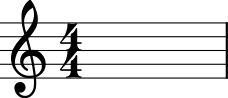

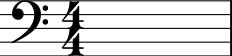

In [20]:
ms.clef.TrebleClef().show()
ms.clef.BassClef().show()

### KeySignature

https://pt.wikipedia.org/wiki/Círculo_de_quintas

**Lembrar que a informação é imprecisa**

In [21]:
dfKeySignature = df.copy()
arrayKeys = dfKeySignature['keySignature'].unique()
print(arrayKeys)

['C minor' 'C# minor' 'C major' 'E- major' 'B major' 'B minor' 'B- major'
 'E major' 'A- major' 'A major' 'G major' 'D- major' 'E minor']


c minor


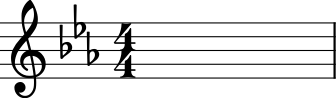

c# minor


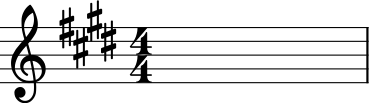

C major


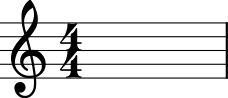

E- major


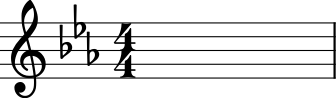

B major


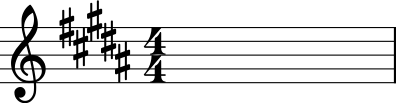

b minor


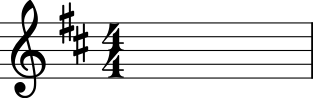

B- major


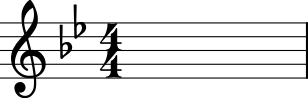

E major


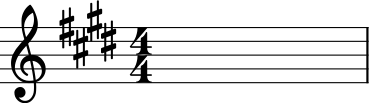

A- major


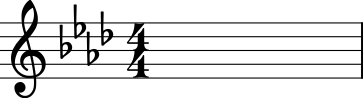

A major


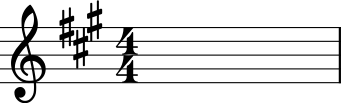

G major


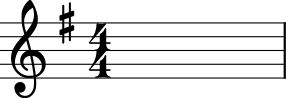

D- major


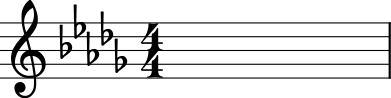

e minor


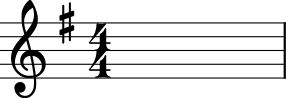

In [22]:
for key in arrayKeys:
    if 'minor' in key:
        key = key.lower()

    _k = key.split(' ')[0]
    legal = ms.key.Key(_k)

    print(key)
    ms.key.KeySignature(legal.sharps).show()
    


In [23]:
_countKeys = dfKeySignature[['songName', 'keySignature']].groupby(['songName', 'keySignature'], as_index=False).count()

fig = go.Figure()
fig.add_trace(go.Bar(
    x = _countKeys['keySignature'].value_counts().index,
    y = _countKeys['keySignature'].value_counts(),
    text = _countKeys['keySignature'].value_counts()
))

fig.update_layout(
    title='<span>Key Signatures songs</span>', 
    autosize=False,
    width=1100,
    height=500,
    xaxis=dict(title='<span>Key Signature</span>'),
    yaxis=dict(title='<span>Count</span>'),
    #template='my_theme'
    )

fig.show()
display(_countKeys)

,songName,keySignature
0,chopin_nocturne_cMinor,C minor
1,chopin_nocturne_cSharpMinor,C# minor
2,chopin_nocturne_op09_n01,C major
3,chopin_nocturne_op09_n02,E- major
4,chopin_nocturne_op09_n03,B major
5,chopin_nocturne_op09_n03,B minor
6,chopin_nocturne_op15_n01,C major
7,chopin_nocturne_op15_n02,C major
8,chopin_nocturne_op15_n03,B- major
9,chopin_nocturne_op27_n01,A- major


In [24]:
_countKeys['keySignature'].value_counts()

C major     9
E- major    3
A- major    3
A major     2
C minor     1
C# minor    1
B major     1
B minor     1
B- major    1
E major     1
G major     1
D- major    1
E minor     1
Name: keySignature, dtype: int64

### Time Signature (Numerator and Denominator)

In [25]:
dfTime = df.copy()
dfTime = dfTime[['songName', 'timeSignNumerator', 'timeSignDenominator']]
dfTime = dfTime.groupby(['songName', 'timeSignNumerator', 'timeSignDenominator'], as_index=False).count()

dfTime['TimeSignature'] = dfTime['timeSignNumerator'].map(str) + '/' +  dfTime['timeSignDenominator'].map(str)
dfTime = dfTime[['songName', 'TimeSignature']]

In [26]:
dfTime

,songName,TimeSignature
0,chopin_nocturne_cMinor,4/4
1,chopin_nocturne_cSharpMinor,3/4
2,chopin_nocturne_cSharpMinor,4/4
3,chopin_nocturne_op09_n01,4/4
4,chopin_nocturne_op09_n02,12/8
5,chopin_nocturne_op09_n03,3/4
6,chopin_nocturne_op09_n03,4/4
7,chopin_nocturne_op09_n03,6/8
8,chopin_nocturne_op09_n03,12/8
9,chopin_nocturne_op15_n01,4/4


In [27]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=dfTime['TimeSignature'].value_counts().index,
    y=dfTime['TimeSignature'].value_counts(),
    text=dfTime['TimeSignature'].value_counts()
))

fig.update_layout(
    title='<span>Time Signatures count</span>', 
    autosize=False,
    width=600,
    height=400,
    xaxis=dict(title='<span>Time Signature</span>'),
    yaxis=dict(title='<span>Count</span>'),
    #template='my_theme'
    )

fig.show()

### Measure

In [28]:
dfMeasure = df.copy()
dfMeasure = dfMeasure.groupby(['songName'])['measure'].max().sort_values(ascending=False)
dfMeasure

songName
chopin_nocturne_op62_n01            193
chopin_nocturne_op62_n02            165
chopin_nocturne_op09_n03            163
chopin_nocturne_op37_n01            163
chopin_nocturne_op27_n02            158
chopin_nocturne_op15_n03            154
chopin_nocturne_op37_n02            141
chopin_nocturne_op48_n02            140
chopin_nocturne_op09_n01            136
chopin_nocturne_op32_n01            131
chopin_nocturne_op27_n01            110
chopin_nocturne_op15_n01            109
chopin_nocturne_op55_n01            102
chopin_nocturne_op15_n02            101
chopin_nocturne_op32_n02             78
chopin_nocturne_op48_n01             78
chopin_nocturne_op55_n02             68
chopin_nocturne_cSharpMinor          66
chopin_nocturne_op72_n01_opPosth     59
chopin_nocturne_cMinor               45
chopin_nocturne_op09_n02             37
Name: measure, dtype: int64

In [29]:
fig = go.Figure()
fig.add_trace(
    go.Bar(
        x=dfMeasure.index[0:10],
        y=dfMeasure.values[0:10],
        text=dfMeasure.values[0:10]
    )
)

fig.update_layout(
    title='<span>Count measures per song (Top 10)</span>', 
    autosize=False,
    width=900,
    height=500,
    showlegend=False,
    xaxis=dict(title='<span>Song name</span>'),
    yaxis=dict(title='<span>Count</span>'),
    
    ) 

In [30]:
dfMeasure.describe()

count     21.000000
mean     114.142857
std       44.965860
min       37.000000
25%       78.000000
50%      110.000000
75%      154.000000
max      193.000000
Name: measure, dtype: float64

### Offset

In [31]:
def convertFracToDecimal(fraction):
    _asStr = str(fraction)
    _arr = _asStr.split('/')
    _num = float(_arr[0])
    if len(_arr) > 1:
        _num = round(float(_arr[0]) / float(_arr[1]), 2)
    
    return _num
    

In [32]:
dfOffset = df.copy()
dfOffset['offsetDecimal'] = dfOffset['offset'].apply(convertFracToDecimal)

In [33]:
dfOffset[['offset', 'offsetDecimal']].head(10)

,offset,offsetDecimal
0,0.0,0.00
1,2/3,0.67
2,3.0,3.00
3,0.0,0.00
4,0.75,0.75
5,1.0,1.00
6,1.75,1.75
7,2.0,2.00
8,3.0,3.00
9,0.0,0.00


In [34]:
dfOffset['offset'].value_counts()[-10:-1]

35/6     9
31/6     7
55/12    7
59/12    7
67/12    5
49/12    5
71/12    4
5/12     4
29/6     2
Name: offset, dtype: int64

In [35]:
dfOffset['offsetDecimal'].describe()

count    41491.000000
mean         1.672172
std          1.302328
min          0.000000
25%          0.500000
50%          1.670000
75%          2.750000
max          5.920000
Name: offsetDecimal, dtype: float64

In [36]:
fig = go.Figure()
fig.add_trace(go.Box(x=dfOffset['offsetDecimal']))


fig.update_layout(
    title='<span>Boxplot offsets</span>', 
    autosize=False,
    width=800,
    height=300,
    showlegend=False,
    xaxis=dict(title='<span>Offset</span>'),
    yaxis=dict(title='<span>plot</span>')
    
    ) 

fig.show()

### Duration

In [37]:
dfDuration = df.copy()
dfDuration['durationDecimal'] = dfDuration['duration'].apply(convertFracToDecimal)

In [38]:
dfDuration[['duration', 'durationDecimal']].head()

,duration,durationDecimal
0,2/3,0.67
1,7/3,2.33
2,1.0,1.00
3,0.75,0.75
4,0.25,0.25


In [39]:
dfDuration['durationDecimal'].value_counts()

0.25     11064
0.50      7008
0.33      6332
1.00      3068
0.75      2344
         ...  
15.75        1
15.50        1
6.25         1
4.83         1
12.25        1
Name: durationDecimal, Length: 76, dtype: int64

In [40]:
dfDuration['durationDecimal'].describe()

count    41491.000000
mean         0.670547
std          0.719815
min          0.080000
25%          0.250000
50%          0.420000
75%          0.750000
max         17.330000
Name: durationDecimal, dtype: float64

In [41]:
fig = go.Figure()
fig.add_trace(go.Box(x=dfDuration['durationDecimal']))


fig.update_layout(
    title='<span>Boxplot note durations</span>', 
    autosize=False,
    width=800,
    height=300,
    showlegend=False,
    xaxis=dict(title='<span>Duration</span>')
    #yaxis=dict(title='<span>Count</span>'),
    
    ) 

fig.show()

### Note Name and Not Octave

In [42]:
dfNotes = df.loc[~df['noteName'].isnull()]
dfNotes = dfNotes.loc[dfNotes['noteName'] != 'rest']

In [43]:
print('Notes count: {}'.format(len(dfNotes['noteName'].value_counts())))
print(dfNotes['noteName'].value_counts())

Notes count: 12
C#    2368
G#    2109
E-    2003
F#    1782
F     1744
B-    1700
C     1531
B     1475
G     1413
E     1253
A     1143
D     1119
Name: noteName, dtype: int64


In [44]:
def barChart(df, column, title = 'Default', xaxis = 'X', yaxis = 'Y'):
    fig = go.Figure()
    lstIndex = df[column].value_counts().index
    lstValues = df[column].value_counts().values

    fig.add_trace(go.Bar(
        x = lstIndex,
        y = lstValues,
        text = lstValues
    ))

    fig.update_layout(
        title='<span>{}</span>'.format(title), 
        autosize=False,
        width=900,
        height=500,
        yaxis=dict(title='<span>{}</span>'.format(xaxis)),
        xaxis=dict(title='<span>{}</span>'.format(yaxis)),
        showlegend=False
        )    
    
    return fig

In [45]:
barChart(dfNotes, 'noteName', 'Notes count', 'Notes', 'Count')

In [46]:
test = 'G'


lstSharpsFlats = dfNotes.loc[dfNotes['noteName'].str.contains("#") | 
                             dfNotes['noteName'].str.contains("-"), 'noteName'].value_counts()

In [47]:
dfNotes.head()

,songName,clef,keySignature,timeSignNumerator,timeSignDenominator,measure,offset,duration,noteName,noteOctave,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass
2,chopin_nocturne_cMinor,treble,C minor,4,4,1,3.0,1.0,G,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.0,0.75,C,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.75,0.25,D,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,chopin_nocturne_cMinor,treble,C minor,4,4,2,1.0,0.75,E-,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,chopin_nocturne_cMinor,treble,C minor,4,4,2,1.75,0.25,F,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### ChordName (Root, Third, Fifth, Seventh, Bass)

In [48]:
dfChords = df.copy()
dfChords = dfChords.loc[~dfChords['chordName'].isnull(), ['chordName',
                                                          'chordType',
                                                          'chordInversion', 
                                                          'chordRoot', 
                                                          'chordThird', 
                                                          'chordFifth', 
                                                          'chordSeventh', 
                                                          'chordBass']]

dfChords.head(10)

,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass
10,Perfect Unison above G,minor,0.0,G5,B-5,None,None,G5
15,Perfect Unison above G,minor,0.0,G4,B-4,None,None,G4
20,Major Second above C,minor,3.0,D5,None,None,C5,C5
22,Minor Second above B,minor,3.0,C5,None,None,B4,B4
24,Major Second above C,minor,3.0,D5,None,None,C5,C5
26,Augmented Unison above Eb,minor,0.0,E-5,None,None,None,E-5
28,Augmented Unison above F,minor,0.0,F5,None,None,None,F5
30,Diminished Unison above G,minor,0.0,G#5,None,None,None,G5
40,Perfect Unison above G,minor,0.0,G5,B-5,None,None,G5
45,Perfect Unison above G,minor,0.0,G4,B-4,None,None,G4


In [49]:
print('Chords root count: {}'.format(len(dfChords['chordRoot'].value_counts())))
print(dfChords['chordRoot'].value_counts())

Chords root count: 102
C4     414
C5     374
C#5    345
G#4    330
E-4    328
      ... 
F#6      1
C#6      1
C#1      1
G#2      1
E-1      1
Name: chordRoot, Length: 102, dtype: int64


In [50]:
def removeDigit(value):
    newstring = ''.join([i for i in value if not i.isdigit()])
    return newstring

In [51]:
dfChords['chordRootWithout8'] = dfChords['chordRoot'].astype(str).map(removeDigit)

In [52]:
print('Chords root count: {}'.format(len(dfChords['chordRootWithout8'].value_counts())))
print(dfChords['chordRootWithout8'].value_counts())

Chords root count: 12
C     1016
C#     896
G#     779
E-     747
F      638
F#     633
B-     531
G      511
D      480
A      474
E      472
B      389
Name: chordRootWithout8, dtype: int64


In [53]:
dfChords['chordType'].value_counts()

minor    7376
major     190
Name: chordType, dtype: int64

In [54]:
dfChords.head()

,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass,chordRootWithout8
10,Perfect Unison above G,minor,0.0,G5,B-5,None,None,G5,G
15,Perfect Unison above G,minor,0.0,G4,B-4,None,None,G4,G
20,Major Second above C,minor,3.0,D5,None,None,C5,C5,D
22,Minor Second above B,minor,3.0,C5,None,None,B4,B4,C
24,Major Second above C,minor,3.0,D5,None,None,C5,C5,D


### Notes and Chords

In [55]:
df.head()

,songName,clef,keySignature,timeSignNumerator,timeSignDenominator,measure,offset,duration,noteName,noteOctave,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass
0,chopin_nocturne_cMinor,treble,C minor,4,4,1,0.0,2/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,chopin_nocturne_cMinor,treble,C minor,4,4,1,2/3,7/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,chopin_nocturne_cMinor,treble,C minor,4,4,1,3.0,1.0,G,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.0,0.75,C,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.75,0.25,D,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [56]:
dfNoteChord = df.copy()
dfNoteChord = dfNoteChord.loc[dfNoteChord['noteName'] != 'rest']
dfNoteChord['chordRootWithout8'] = dfNoteChord['chordRoot'].astype(str).map(removeDigit)
dfNoteChord['chordThirdWithout8'] = dfNoteChord['chordThird'].astype(str).map(removeDigit)
dfNoteChord['chordFifthRootWithout8'] = dfNoteChord['chordFifth'].astype(str).map(removeDigit)
dfNoteChord['chordSeventhRootWithout8'] = dfNoteChord['chordSeventh'].astype(str).map(removeDigit)

In [57]:
lstNotes = dfNoteChord.loc[~dfNoteChord['noteName'].isnull(), 'noteName']

lstTemp = dfNoteChord.loc[~dfNoteChord['chordRootWithout8'].isnull()]
lstRoot = dfNoteChord.loc[dfNoteChord['chordRootWithout8'] != 'nan', 'chordRootWithout8']

lstTemp = dfNoteChord.loc[~dfNoteChord['chordThirdWithout8'].isnull()]
lstThird = dfNoteChord.loc[(dfNoteChord['chordThirdWithout8'] != 'nan') &
                           (dfNoteChord['chordThirdWithout8'] != 'None'), 'chordThirdWithout8']

lstTemp = dfNoteChord.loc[~dfNoteChord['chordFifthRootWithout8'].isnull()]
lstFifth = dfNoteChord.loc[(dfNoteChord['chordFifthRootWithout8'] != 'nan') &
                           (dfNoteChord['chordFifthRootWithout8'] != 'None'), 'chordFifthRootWithout8']

lstTemp = dfNoteChord.loc[~dfNoteChord['chordSeventhRootWithout8'].isnull()]
lstSeventh = dfNoteChord.loc[(dfNoteChord['chordSeventhRootWithout8'] != 'nan') &  
                             (dfNoteChord['chordSeventhRootWithout8'] != 'None'), 'chordSeventhRootWithout8']

In [58]:
lstNotes[0:5], lstRoot[0:5], lstThird[0:5], lstFifth[0:5], lstSeventh[0:5]

(2     G
 3     C
 4     D
 5    E-
 6     F
 Name: noteName, dtype: object,
 10    G
 15    G
 20    D
 22    C
 24    D
 Name: chordRootWithout8, dtype: object,
 10    B-
 15    B-
 40    B-
 45    B-
 66    B-
 Name: chordThirdWithout8, dtype: object,
 239     G
 240     C
 242     G
 286    C#
 413     G
 Name: chordFifthRootWithout8, dtype: object,
 20    C
 22    B
 24    C
 50    D
 52    C
 Name: chordSeventhRootWithout8, dtype: object)

In [59]:
lstAllNotes = []
lstAllNotes.extend(lstNotes)
lstAllNotes.extend(lstRoot)
lstAllNotes.extend(lstThird)
lstAllNotes.extend(lstFifth)
lstAllNotes.extend(lstSeventh)

dfAllNotes = pd.DataFrame(lstAllNotes, columns=['noteName'])

In [60]:
dfAllNotes.head(5)

,noteName
0,G
1,C
2,D
3,E-
4,F


In [61]:
dfAllNotes['noteName'].value_counts()

G#    3705
C#    3674
E-    3600
F     3089
C     3071
B-    3013
F#    2895
G     2684
B     2523
E     2195
D     2174
A     2015
Name: noteName, dtype: int64

## Data Pre Processing

In [86]:
df = df.sort_values(by=['songName', 'measure', 'offset', 'clef'], ascending=[True, True, True, False])

In [87]:
def mapDurationToFloat(value):
    value_float = 0
    value = str(value)
    if '/' in value:
        frac = value.split('/')
        value = fractions.Fraction(int(frac[0]), int(frac[1]))
        
    value_float = float(value)
        
    return value_float


def round25Nearest(x):
    value = round(x*4) / 4
    if value == 0:
        value = 0.25
    return value

df['duration_float'] = df['duration'].apply(mapDurationToFloat)

df['duration_round'] = df['duration_float'].apply(round25Nearest)

#Show new durations
df[['duration', 'duration_float', 'duration_round']].head()

,duration,duration_float,duration_round
0,2/3,0.666667,0.75
422,3.0,3.000000,3.00
1,7/3,2.333333,2.25
2,1.0,1.000000,1.00
423,1.0,1.000000,1.00


In [88]:
lstSongs = df['songName'].unique()

In [89]:
for song in lstSongs:
    print(song)

chopin_nocturne_cMinor
chopin_nocturne_cSharpMinor
chopin_nocturne_op09_n01
chopin_nocturne_op09_n02
chopin_nocturne_op09_n03
chopin_nocturne_op15_n01
chopin_nocturne_op15_n02
chopin_nocturne_op15_n03
chopin_nocturne_op27_n01
chopin_nocturne_op27_n02
chopin_nocturne_op32_n01
chopin_nocturne_op32_n02
chopin_nocturne_op37_n01
chopin_nocturne_op37_n02
chopin_nocturne_op48_n01
chopin_nocturne_op48_n02
chopin_nocturne_op55_n01
chopin_nocturne_op55_n02
chopin_nocturne_op62_n01
chopin_nocturne_op62_n02
chopin_nocturne_op72_n01_opPosth


In [90]:
df.head(10)

,songName,clef,keySignature,timeSignNumerator,timeSignDenominator,measure,offset,duration,noteName,noteOctave,chordName,chordType,chordInversion,chordRoot,chordThird,chordFifth,chordSeventh,chordBass,duration_float,duration_round
0,chopin_nocturne_cMinor,treble,C minor,4,4,1,0.0,2/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.666667,0.75
422,chopin_nocturne_cMinor,bass,C minor,4,4,1,0.0,3.0,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,3.00
1,chopin_nocturne_cMinor,treble,C minor,4,4,1,2/3,7/3,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.333333,2.25
2,chopin_nocturne_cMinor,treble,C minor,4,4,1,3.0,1.0,G,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.00
423,chopin_nocturne_cMinor,bass,C minor,4,4,1,3.0,1.0,rest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.00
3,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.0,0.75,C,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.750000,0.75
424,chopin_nocturne_cMinor,bass,C minor,4,4,2,0.0,0.5,C,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.500000,0.50
425,chopin_nocturne_cMinor,bass,C minor,4,4,2,0.5,0.5,G,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.500000,0.50
4,chopin_nocturne_cMinor,treble,C minor,4,4,2,0.75,0.25,D,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.250000,0.25
5,chopin_nocturne_cMinor,treble,C minor,4,4,2,1.0,0.75,E-,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.750000,0.75


In [91]:
df['noteName'].fillna('chord', inplace=True)

#df = df.loc[df['noteName'] != 'rest']

In [92]:
def getSymbolString(row):
    reg = ''
    if row.noteName == 'rest':
        reg = f'{row.clef}_{row.duration_round}_type:rest'
        #pausa
    elif row.noteName == 'chord':
        reg = f'{row.clef}_{row.duration_round}_type:chord_{row.chordRoot}_{row.chordThird}_{row.chordFifth}_{row.chordSeventh}'
        #Acorde
    else:
        octave = int(row.noteOctave)
        reg = f'{row.clef}_{row.duration_round}_type:note_{row.noteName}{octave}'
        #Nota
        
    return reg

In [93]:
listTotal = []

for row in df.iterrows():
    reg = getSymbolString(row[1])
        
    listTotal.append(reg)

listTotal[0:10]  

['treble_0.75_type:rest',
 'bass_3.0_type:rest',
 'treble_2.25_type:rest',
 'treble_1.0_type:note_G4',
 'bass_1.0_type:rest',
 'treble_0.75_type:note_C5',
 'bass_0.5_type:note_C2',
 'bass_0.5_type:note_G3',
 'treble_0.25_type:note_D5',
 'treble_0.75_type:note_E-5']

In [94]:
dictSymbols = sorted(list(set(listTotal)))

In [95]:
#Building dictionary to access the vocabulary from indices and vice versa
mapping = dict((c, i) for i, c in enumerate(dictSymbols))
reverseMapping = dict((i, c) for i, c in enumerate(dictSymbols))

In [104]:
#Splitting the Corpus in equal length of strings and output target
window = 10
targets = []
features = []

for i in range(0, len(listTotal) - window, 1):
    
    feature = []
    for j in range(window):
        symbol = getSymbolString(df.iloc[i + j])
        feature.append(symbol)
    
    target = getSymbolString(df.iloc[i + window])
    

    
    features.append([mapping[k] for k in feature])
    targets.append(mapping[target])
    
len_list = len(features)
print(f"Total number of sequences in the Corpus:{len_list}")
    

Total number of sequences in the Corpus:41481


In [105]:
pd.DataFrame(features)

,0,1,2,3,4,5,6,7,8,9
0,2686,1315,3495,2939,941,2646,560,597,2022,2657
1,1315,3495,2939,941,2646,560,597,2022,2657,425
2,3495,2939,941,2646,560,597,2022,2657,425,597
3,2939,941,2646,560,597,2022,2657,425,597,2045
4,941,2646,560,597,2022,2657,425,597,2045,2940
...,...,...,...,...,...,...,...,...,...,...
41476,306,2686,762,2060,334,2060,334,2686,1345,3648
41477,2686,762,2060,334,2060,334,2686,1345,3648,1280
41478,762,2060,334,2060,334,2686,1345,3648,1280,2941
41479,2060,334,2060,334,2686,1345,3648,1280,2941,941


In [106]:
pd.DataFrame(targets)

,0
0,425
1,597
2,2045
3,2940
4,561
...,...
41476,1280
41477,2941
41478,941
41479,3771


In [107]:
# reshape X and normalize
X_temp = (np.reshape(features, (len_list, window, 1)))/ float(len(dictSymbols))

#stand = StandardScaler()
#X_stand = stand.fit_transform(features)

In [108]:
X = X_temp
#X = np.reshape(X_stand, (len_list, window, 1))
y = tf.keras.utils.to_categorical(targets)
#teste = stand.inverse_transform(X.reshape(-1, 10))

## Model Building

In [109]:
def createModel():

    #Initializing the Model
    model = tf.keras.Sequential()
    
    #Adding layers
    model.add(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True))
    model.add(Dropout(0.1))
    model.add(LSTM(256))
    
    model.add(Dense(256))
    model.add(Dropout(0.1))
    
    model.add(Dense(y.shape[1], activation='softmax'))
    
    
    #Compiling the model for training  
    opt = Adamax(learning_rate=0.01)
    model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
    
    return model

In [110]:
model = createModel()

#Model's Summary               
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 10, 512)           1052672   
                                                                 
 dropout_4 (Dropout)         (None, 10, 512)           0         
                                                                 
 lstm_5 (LSTM)               (None, 256)               787456    
                                                                 
 dense_4 (Dense)             (None, 256)               65792     
                                                                 
 dropout_5 (Dropout)         (None, 256)               0         
                                                                 
 dense_5 (Dense)             (None, 3802)              977114    
                                                                 
Total params: 2,883,034
Trainable params: 2,883,034
No

In [111]:
#Taking out a subset of data to be used as seed
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

In [112]:
checkpoint = ModelCheckpoint(
    'modelV1.h5', 
    monitor = 'val_loss', 
    verbose = 1, 
    save_best_only = True
)

#Training the Model
history = model.fit(X_train, y_train, batch_size=256, epochs=200, callbacks = [checkpoint])

Epoch 1/200
146/146 [==============================] - 29s 35ms/step - loss: 6.2712 - accuracy: 0.1037
Epoch 2/200
146/146 [==============================] - 5s 34ms/step - loss: 6.0050 - accuracy: 0.1116
Epoch 3/200
146/146 [==============================] - 5s 33ms/step - loss: 5.9832 - accuracy: 0.1120
Epoch 4/200
146/146 [==============================] - 5s 34ms/step - loss: 5.9480 - accuracy: 0.1198
Epoch 5/200
146/146 [==============================] - 5s 33ms/step - loss: 5.7653 - accuracy: 0.1345
Epoch 6/200
146/146 [==============================] - 5s 33ms/step - loss: 5.6738 - accuracy: 0.1386
Epoch 7/200
146/146 [==============================] - 5s 34ms/step - loss: 5.5973 - accuracy: 0.1407
Epoch 8/200
146/146 [==============================] - 5s 33ms/step - loss: 5.5346 - accuracy: 0.1415
Epoch 9/200
146/146 [==============================] - 5s 34ms/step - loss: 5.4333 - accuracy: 0.1456
Epoch 10/200
146/146 [==============================] - 5s 34ms/step - loss: 5.35

Epoch 32/200
146/146 [==============================] - 5s 33ms/step - loss: 3.1840 - accuracy: 0.3084
Epoch 33/200
146/146 [==============================] - 5s 34ms/step - loss: 3.0688 - accuracy: 0.3277
Epoch 34/200
146/146 [==============================] - 5s 33ms/step - loss: 2.9728 - accuracy: 0.3405
Epoch 35/200
146/146 [==============================] - 5s 34ms/step - loss: 2.8716 - accuracy: 0.3572
Epoch 36/200
146/146 [==============================] - 5s 33ms/step - loss: 2.7860 - accuracy: 0.3711
Epoch 37/200
146/146 [==============================] - 5s 35ms/step - loss: 2.6885 - accuracy: 0.3884
Epoch 38/200
146/146 [==============================] - 5s 33ms/step - loss: 2.5958 - accuracy: 0.4045
Epoch 39/200
146/146 [==============================] - 5s 33ms/step - loss: 2.5100 - accuracy: 0.4188
Epoch 40/200
146/146 [==============================] - 5s 34ms/step - loss: 2.4427 - accuracy: 0.4301
Epoch 41/200
146/146 [==============================] - 5s 33ms/step - lo

Epoch 63/200
146/146 [==============================] - 5s 33ms/step - loss: 1.3273 - accuracy: 0.6547
Epoch 64/200
146/146 [==============================] - 5s 33ms/step - loss: 1.2923 - accuracy: 0.6620
Epoch 65/200
146/146 [==============================] - 5s 33ms/step - loss: 1.2802 - accuracy: 0.6663
Epoch 66/200
146/146 [==============================] - 5s 33ms/step - loss: 1.2271 - accuracy: 0.6758
Epoch 67/200
146/146 [==============================] - 5s 33ms/step - loss: 1.2101 - accuracy: 0.6793
Epoch 68/200
146/146 [==============================] - 5s 37ms/step - loss: 1.1760 - accuracy: 0.6879
Epoch 69/200
146/146 [==============================] - 8s 55ms/step - loss: 1.1652 - accuracy: 0.6905
Epoch 70/200
146/146 [==============================] - 5s 34ms/step - loss: 1.1285 - accuracy: 0.6952
Epoch 71/200
146/146 [==============================] - 17s 117ms/step - loss: 1.1080 - accuracy: 0.7005
Epoch 72/200
146/146 [==============================] - 17s 118ms/step 

Epoch 94/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6577 - accuracy: 0.8121
Epoch 95/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6611 - accuracy: 0.8126
Epoch 96/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6439 - accuracy: 0.8167
Epoch 97/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6541 - accuracy: 0.8155
Epoch 98/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6184 - accuracy: 0.8226
Epoch 99/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6058 - accuracy: 0.8255
Epoch 100/200
146/146 [==============================] - 5s 33ms/step - loss: 0.6048 - accuracy: 0.8279
Epoch 101/200
146/146 [==============================] - 5s 33ms/step - loss: 0.5708 - accuracy: 0.8370
Epoch 102/200
146/146 [==============================] - 5s 33ms/step - loss: 0.5909 - accuracy: 0.8326
Epoch 103/200
146/146 [==============================] - 5s 33ms/step 

Epoch 125/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4492 - accuracy: 0.8724
Epoch 126/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4315 - accuracy: 0.8761
Epoch 127/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4405 - accuracy: 0.8730
Epoch 128/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4281 - accuracy: 0.8769
Epoch 129/200
146/146 [==============================] - 5s 34ms/step - loss: 0.4155 - accuracy: 0.8809
Epoch 130/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4210 - accuracy: 0.8811
Epoch 131/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4088 - accuracy: 0.8818
Epoch 132/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4080 - accuracy: 0.8837
Epoch 133/200
146/146 [==============================] - 5s 33ms/step - loss: 0.4209 - accuracy: 0.8806
Epoch 134/200
146/146 [==============================] - 5s 33ms

Epoch 156/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3473 - accuracy: 0.8991
Epoch 157/200
146/146 [==============================] - 5s 35ms/step - loss: 0.3479 - accuracy: 0.9009
Epoch 158/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3301 - accuracy: 0.9041
Epoch 159/200
146/146 [==============================] - 5s 33ms/step - loss: 0.3335 - accuracy: 0.9027
Epoch 160/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3191 - accuracy: 0.9069
Epoch 161/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3294 - accuracy: 0.9045
Epoch 162/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3300 - accuracy: 0.9048
Epoch 163/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3391 - accuracy: 0.9019
Epoch 164/200
146/146 [==============================] - 5s 34ms/step - loss: 0.3284 - accuracy: 0.9059
Epoch 165/200
146/146 [==============================] - 5s 33ms

Epoch 187/200
146/146 [==============================] - 5s 37ms/step - loss: 0.2867 - accuracy: 0.9155
Epoch 188/200
146/146 [==============================] - 5s 34ms/step - loss: 0.2920 - accuracy: 0.9156
Epoch 189/200
146/146 [==============================] - 5s 33ms/step - loss: 0.2820 - accuracy: 0.9171
Epoch 190/200
146/146 [==============================] - 5s 34ms/step - loss: 0.2830 - accuracy: 0.9180
Epoch 191/200
146/146 [==============================] - 5s 33ms/step - loss: 0.2772 - accuracy: 0.9185
Epoch 192/200
146/146 [==============================] - 7s 46ms/step - loss: 0.2925 - accuracy: 0.9157
Epoch 193/200
146/146 [==============================] - 8s 52ms/step - loss: 0.2771 - accuracy: 0.9191
Epoch 194/200
146/146 [==============================] - 5s 35ms/step - loss: 0.2692 - accuracy: 0.9213
Epoch 195/200
146/146 [==============================] - 6s 42ms/step - loss: 0.2767 - accuracy: 0.9191
Epoch 196/200
146/146 [==============================] - 5s 37ms

In [113]:
model.save_weights('model/modelV1.h5')

## Load Model

In [114]:
model = createModel()


# Load checkpoint weights and re-evaluate
model.load_weights("model/modelV1.h5")

## Evaluating Model

[Text(0.5, 0, 'Epochs')]

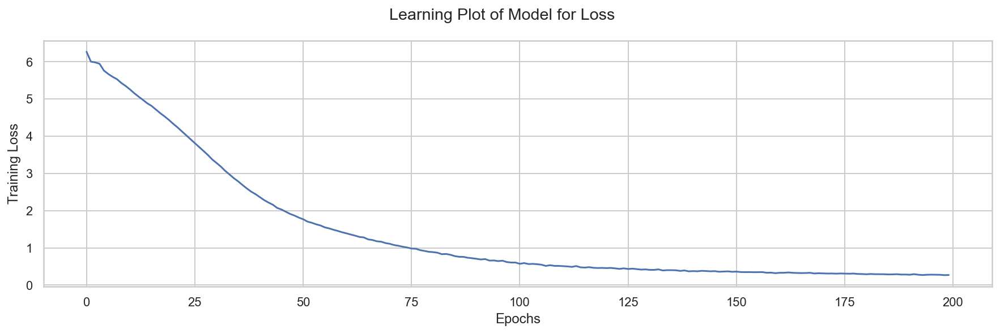

In [115]:
#Plotting the learnings 
sns.set_theme(style="whitegrid")
history_df = pd.DataFrame(history.history)
fig = plt.figure(figsize=(15,4))
fig.suptitle("Learning Plot of Model for Loss")
pl=sns.lineplot(data=history_df["loss"])
pl.set(ylabel ="Training Loss")
pl.set(xlabel ="Epochs")

In [116]:
Notes_Generated = []
seed = X_test[np.random.randint(0,len(X_test)-1)]

for i in range(200): ##Music Length
    seed = seed.reshape(1,window,1)
    prediction = model.predict(seed, verbose=0)[0]

    index = np.argmax(prediction)
    index ##Buscar no dicionário de mapping|reverseMapping

    index_N = index/ float(float(len(dictSymbols)))
    index_N ##Insert no array de seed


    Notes_Generated.append(index)

    seed = np.insert(seed[0],len(seed[0]),index_N)
    seed = seed[1:]

#end for
Music = [reverseMapping[char] for char in Notes_Generated]


In [117]:
list_treble = []
list_bass = []
for i in range(len(Music)):
    
    note = Music[i]
    note = note.split('_')

    ######### Type note ############
    if note[2] == 'type:note':
        symb = ms.note.Note(note[3])

    elif note[2] == 'type:rest':
        symb = ms.note.Rest()

    elif note[2] == 'type:chord':
        chord = Music[i].split('_')[3:]

        chord_list = []
        for n in chord:
            if n != 'None':
                chord_list.append(n)

        symb = ms.chord.Chord(chord_list)

    ################# Duration ##################
    if '/' in note[1]:
        frac = note[1].split('/')
        dur = fractions.Fraction(int(frac[0]), int(frac[1]))
    elif '.' in note[1]:
        dur = float(note[1])
    else:
        dur = int(note[1])
        
    symb.quarterLength = dur
        
        
    ################## Clef ######################
    if note[0] == 'treble':
        list_treble.append(symb)
    elif note[0] == 'bass':
        list_bass.append(symb)
    


In [118]:
def convertSymbolsToPart(list_clef, clef='Treble', tempo='lento'):

    sum_offset = 0
    cont = 1

    part = ms.stream.Part()
    metroneMark = ms.tempo.MetronomeMark(tempo)    

    measure = ms.stream.Measure(number=cont)
    if clef == 'Bass':
        clef = ms.clef.BassClef()
        
    else: #clef == Treble
        clef = ms.clef.TrebleClef()
    
    timeSignature = ms.meter.TimeSignature('4/4')

    measure.append(clef)
    measure.append(timeSignature)
    measure.append(metroneMark)

    for symbol in list_clef:
        measure.append(symbol)
        dur = float(symbol.quarterLength)
        sum_offset += dur
        
        if sum_offset >= 4:
            part.append(measure)
            sum_offset = 0
            cont += 1
            measure = ms.stream.Measure(number=cont)

    return part


In [119]:
part01 = convertSymbolsToPart(list_treble, 'Treble', 'lento')
part02 = convertSymbolsToPart(list_bass, 'Bass', 'lento')

score = ms.stream.Score([part01, part02])

score.show('midi')

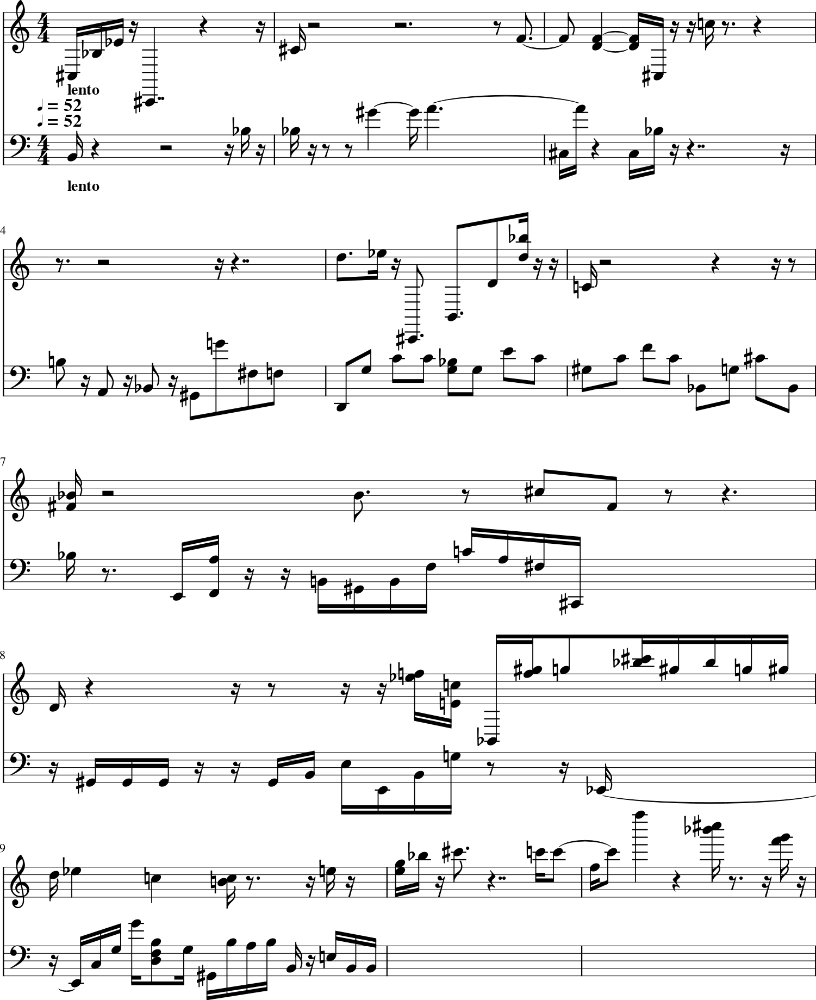

In [120]:
score.show()

## Write file midi and wav

In [121]:
timestr = time.strftime("%Y%m%d-%H%M%S")
nameFile = 'output-' + timestr + '.mid'
outputFolder = 'output/'
score.write('midi', fp=os.path.join(outputFolder, nameFile))

'output/output-20220718-091932.mid'

In [122]:
fs = FluidSynth(sound_font='FluidR3_GM.sf2')
file = 'output/' + nameFile
#'output-20220521-170412'
fs.midi_to_audio(file, 'output.wav')
IPython.display.Audio('output.wav') 